In [1]:
import cv2
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import tensorflow as tf
from tensorflow.keras.layers import Input, Conv2D, MaxPooling2D, UpSampling2D
from tensorflow.keras.models import Model

from pca import pca
from PIL import Image
from sklearn.decomposition import PCA
from sklearn.model_selection import RandomizedSearchCV
from sklearn.preprocessing import StandardScaler
from sklearn.cluster import KMeans
from sklearn_extra.cluster import KMedoids

In [2]:
df = pd.read_hdf('2_Cleaned_dataset/images.h5', key='data')
df.shape

(910, 11)

## Exproramos los grupos

In [14]:
df.groupby(by='category')['category'].value_counts()

category
Adult        710
Childrens    100
Pediatric    100
Name: count, dtype: int64

## Predicción

In [3]:
def get_dataset(column='image'):
    # Aplanamos las imágenes antes de crear una matriz de valores estandarizados
    X = np.stack(df[column].apply(lambda x: x.flatten()))
    scaler = StandardScaler()
    X_standardized = scaler.fit_transform(X)

    # Crea un DataFrame a partir de los datos escalados
    X_standardized_df = pd.DataFrame(X_standardized)

    pca_model = PCA(n_components=700)
    pca_model.fit(X_standardized_df)
    return pca_model.transform(X_standardized_df)
    

In [118]:
def show_images(column='image', c_labels='kmeans_label', df=df, categories=None):

    if categories == None:
        n_categories = df.groupby(c_labels).count().shape[0]
        categories = c in range(n_categories)
        
    for c in categories:
        matches = df[c_labels] == c
        if len(matches) > 0:
            fig, axes = plt.subplots(nrows=2, ncols=5, figsize=(20, 5))
            df_sample = df[matches].sample(n=25)
            fig.suptitle(f'Grupo {c}')

            for i, ax in enumerate(axes.flat):
                ax.imshow((df_sample[i:i+1][column].values[0]), cmap='gray')
                ax.set_xticks([])
                ax.set_yticks([])

            plt.show()

In [28]:
def show_count_matrix(c_labels='kmeans_label'):
    return df.groupby(by=c_labels)['category'].value_counts().unstack().fillna(0)


In [37]:
def predict(column='image', c_labels='kmeans_label', n_clusters=4):
    orth_pca = get_dataset(column)
    kmeans_orth_pca = KMeans(n_clusters=n_clusters, random_state=123, n_init=10, max_iter=100)
    kmeans_orth_pca.fit(orth_pca)
    
    iterations_faces_pca = kmeans_orth_pca.n_iter_
    print(f"Cantidad de iteraciones realizadas: {iterations_faces_pca}")

    df[c_labels] = kmeans_orth_pca.labels_
    
    display(show_count_matrix(c_labels))



In [90]:
predict(n_clusters=3)

Cantidad de iteraciones realizadas: 6


category,Adult,Childrens,Pediatric
kmeans_label,,,
0,127.0,0.0,0.0
1,1.0,100.0,100.0
2,582.0,0.0,0.0


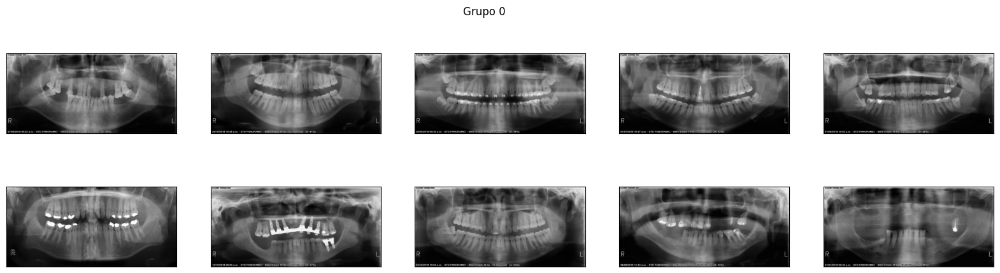

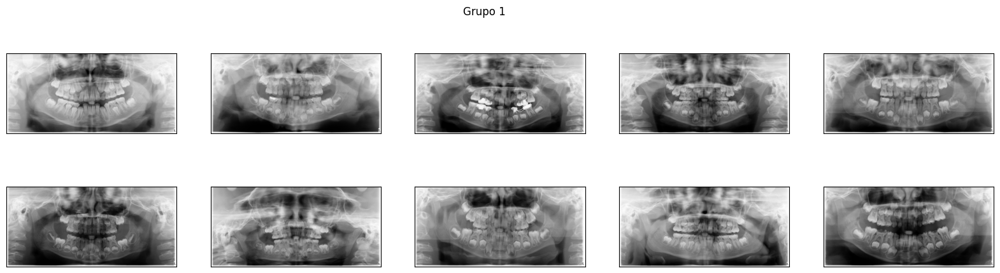

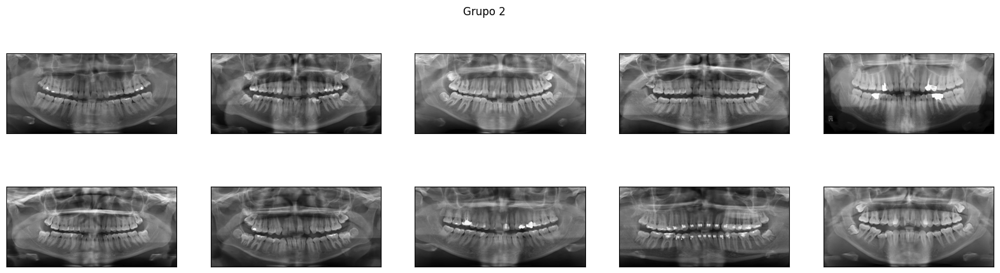

In [91]:
show_images(column='image', c_labels='kmeans_label')

In [119]:
df.loc[df['kmeans_label'] == 1, 'kmeans_label_cat'] = 'child'
df.loc[df['kmeans_label'] == 2, 'kmeans_label_cat'] = 'adult_complete'
df.loc[df['kmeans_label'] == 0, 'kmeans_label_cat'] = 'adult_incomplete'

## Predcción aplicando filtro sabel

**** ME GUSTA COMO PREDICE EL GRUPO QUE NO TIENE LA DENTADURA COMPLETA

In [70]:
def apply_filter_sobel(image):
    # Reducimos el ruido con un kernel de 3x3    
    image = cv2.GaussianBlur(image, (3, 3), 0)
    
    # Aplicar Sobel en la dirección X y Y
    sobelX = cv2.Sobel(image, cv2.CV_64F, 1, 0, ksize=3)
    sobelY = cv2.Sobel(image, cv2.CV_64F, 0, 1, ksize=3)

    # Calcular la magnitud
    return np.sqrt(sobelX**2 + sobelY**2)

df['image_sabel'] = df['image'].apply(apply_filter_sobel)

In [71]:
predict(column='image_sabel', c_labels='kmeans_sabel_label', n_clusters=3)

Cantidad de iteraciones realizadas: 7


category,Adult,Childrens,Pediatric
kmeans_sabel_label,,,
0,0.0,100.0,100.0
1,116.0,0.0,0.0
2,594.0,0.0,0.0


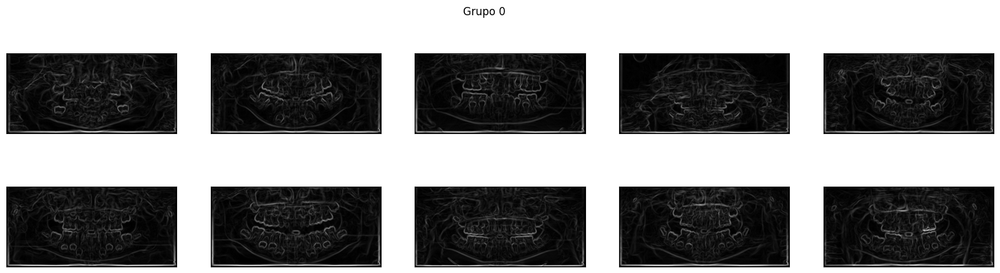

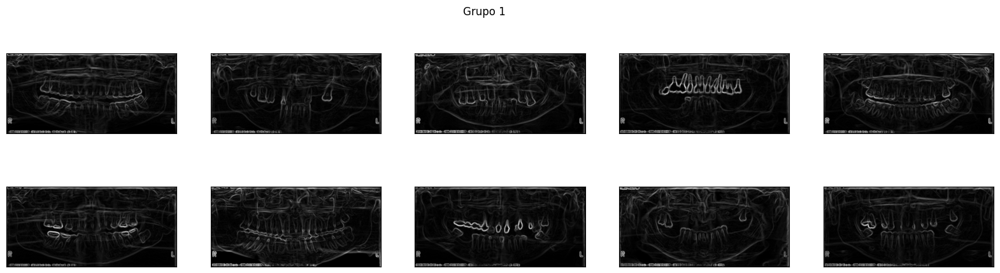

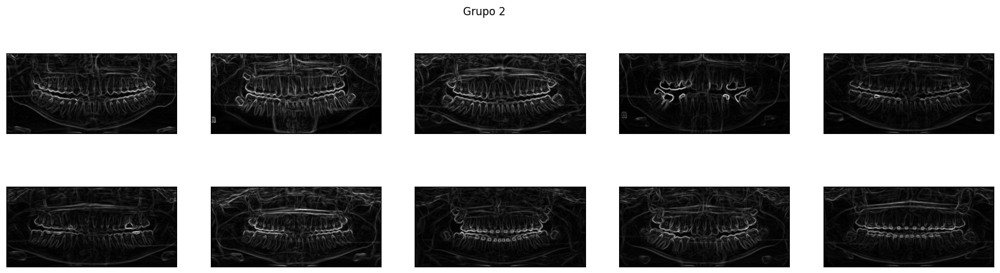

In [65]:
show_images(column='image_sabel', c_labels='kmeans_sabel_label')

In [120]:
df.loc[df['kmeans_sabel_label'] == 0, 'kmeans_sabel_label_cat'] = 'child'
df.loc[df['kmeans_sabel_label'] == 2, 'kmeans_sabel_label_cat'] = 'adult_complete'
df.loc[df['kmeans_sabel_label'] == 1, 'kmeans_sabel_label_cat'] = 'adult_incomplete'

## Predcción aplicando filtro sabel

In [57]:
df['image_hist'] = df['image'].apply(cv2.equalizeHist)

In [67]:
predict(column='image_hist', c_labels='kmeans_hist_label', n_clusters=3)

Cantidad de iteraciones realizadas: 27


category,Adult,Childrens,Pediatric
kmeans_hist_label,,,
0,441.0,0.0,0.0
1,268.0,0.0,0.0
2,1.0,100.0,100.0


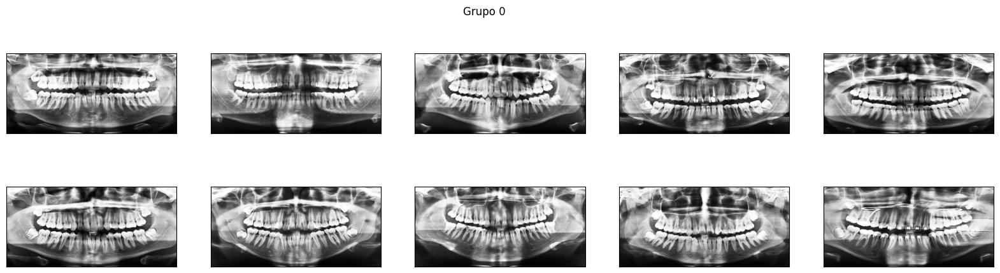

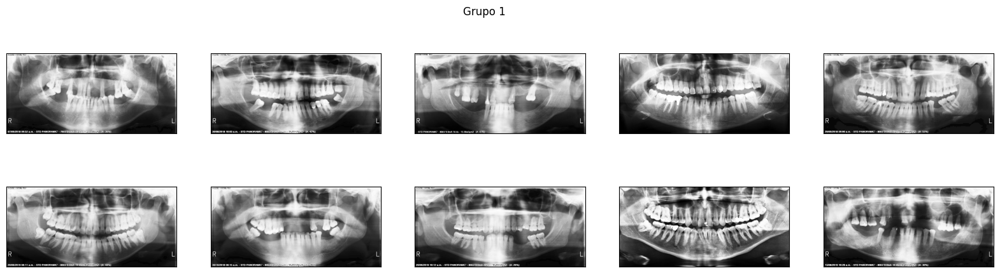

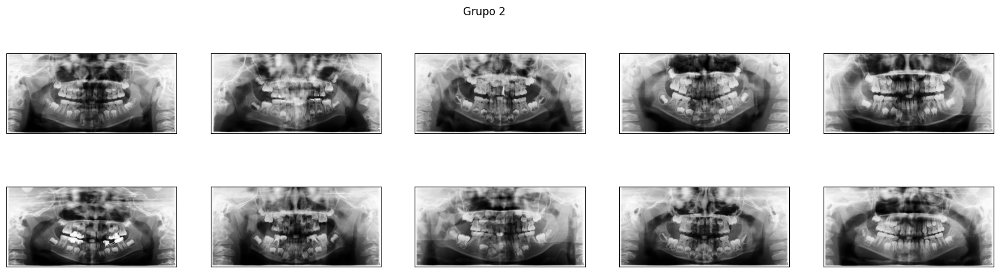

In [68]:
show_images(column='image_hist', c_labels='kmeans_hist_label')

In [121]:
df.loc[df['kmeans_hist_label'] == 2, 'kmeans_hist_label_cat'] = 'child'
df.loc[df['kmeans_hist_label'] == 0, 'kmeans_hist_label_cat'] = 'adult_complete'
df.loc[df['kmeans_hist_label'] == 1, 'kmeans_hist_label_cat'] = 'adult_incomplete'

### Comparación de categorias

Despues de correr la predicción con distintos tipos de filtros notamos que la categoría de los niños es predicha en un 100%, queremos comparar que características tienen en comun las otras dos categorias de adultos y que filtro se ajusta mas a estas características. Notamos que la categoria de adultos se divide en dentaduras completas e incompletas. 

In [125]:
cat_columns = ['kmeans_label_cat', 'kmeans_sabel_label_cat', 'kmeans_hist_label_cat']

In [116]:
# Obtenemos valores similares 
matched_df = df[(df['kmeans_label_cat'] == df['kmeans_sabel_label_cat']) & (df['kmeans_sabel_label_cat'] == df['kmeans_hist_label_cat'])]
matched_df.shape

(749, 19)

In [124]:
not_matched_df = df[~df.index.isin(matched_df.index)]
print('Filas que no coinciden', not_matched_df.shape)

child_not_matched_df = not_matched_df.loc[(df['kmeans_label_cat'] == 'child') | (df['kmeans_sabel_label_cat'] == 'child') | (df['kmeans_hist_label_cat'] == 'child')]
print('Filas de adultos que no coinciden', child_not_matched_df.shape)

Filas que no coinciden (161, 19)
Filas de adultos que no coinciden (2, 19)


In [162]:
child_not_matched_df[['category']+cat_columns]

,category,kmeans_label_cat,kmeans_sabel_label_cat,kmeans_hist_label_cat
111,Adult,child,adult_incomplete,adult_complete
348,Adult,adult_complete,adult_complete,child


In [146]:
child_not_matched_df.index

Index([111, 348], dtype='int64')

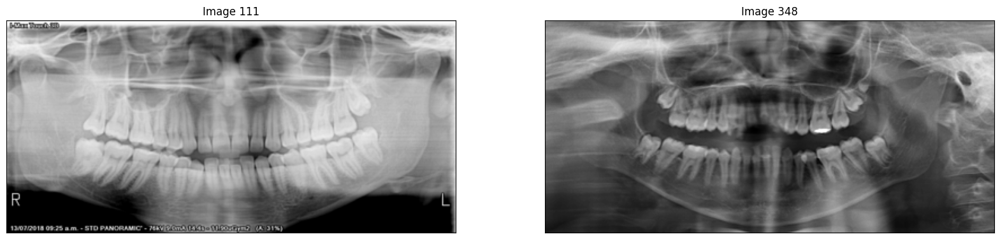

In [161]:
fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(20, 5))

axs = axes.ravel()

for i, idx in enumerate(child_not_matched_df.index):
    row = child_not_matched_df.loc[idx]
    axs[i].set_title(f'Image {idx}')
    axs[i].imshow(row['image'], cmap='gray')
    axs[i].set_xticks([])
    axs[i].set_yticks([])

plt.show()

Los tres modelos fallaron en la predicción de esta categoria, ya las dos imagenes corresponden a un adulto con dentadura completa, la segunda imagen podría ser asignada a incompleta. por el estado de los dientes, pero ningún modelo la soció a este grupo.

In [163]:
# adultos not_match
adult_not_matched_df = not_matched_df[~not_matched_df.index.isin(child_not_matched_df.index)]
adult_not_matched_df.shape

(159, 19)

In [166]:
pd.set_option('display.max_rows', 160)

In [167]:
adult_not_matched_df[['category']+cat_columns].head(159)

,category,kmeans_label_cat,kmeans_sabel_label_cat,kmeans_hist_label_cat
0,Adult,adult_complete,adult_complete,adult_incomplete
1,Adult,adult_complete,adult_complete,adult_incomplete
2,Adult,adult_complete,adult_complete,adult_incomplete
3,Adult,adult_complete,adult_complete,adult_incomplete
4,Adult,adult_complete,adult_complete,adult_incomplete
5,Adult,adult_incomplete,adult_complete,adult_incomplete
6,Adult,adult_complete,adult_complete,adult_incomplete
11,Adult,adult_complete,adult_complete,adult_incomplete
12,Adult,adult_incomplete,adult_complete,adult_incomplete
13,Adult,adult_incomplete,adult_complete,adult_incomplete


In [ ]:
cat_columns = ['kmeans_label_cat', 'kmeans_sabel_label_cat', 'kmeans_hist_label_cat']

In [170]:
math.ceil(adult_not_matched_df.shape[0]/3)

53

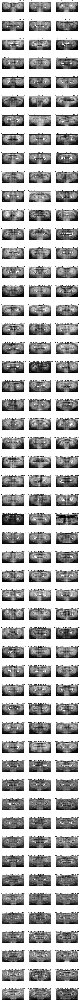

In [175]:
import math

nrows = math.ceil(adult_not_matched_df.shape[0]/3)
fig, axes = plt.subplots(nrows=nrows, ncols=3, figsize=(20, nrows*5))

axs = axes.ravel()

for i, idx in enumerate(adult_not_matched_df.index):    
    row = adult_not_matched_df.loc[idx]
    title = f'o:{row.kmeans_label_cat}-s: {row.kmeans_sabel_label_cat}-h:{row.kmeans_hist_label_cat}'
    axs[i].set_title(f'{idx}-{title}')
    axs[i].imshow(row['image'], cmap='gray')
    axs[i].set_xticks([])
    axs[i].set_yticks([])

plt.show()


Se valida visualmente los datos por indice 
*** NO SE VALIDARON TODOS LOS ELEMENTO
*** LOS ELEMENTOS COMMENTADOS PODRIAN SER CLASIFICADOS COMO INCOMPLETOS PERO SE NECESITARIA VALIDACIÓN

In [198]:
visual_validation = [
    (0,'adult_incomplete'),
	(1,'adult_incomplete'),
	# (2,'adult_incomplete'),
	(3,'adult_incomplete'),
	(4,'adult_incomplete'),
	(5,'adult_incomplete'),
	(5,'adult_incomplete'),
	(6,'adult_incomplete'),
	#(11,'adult_incomplete'),
	(12,'adult_incomplete'),
	(13,'adult_incomplete'),
	(14,'adult_incomplete'),
	(15,'adult_incomplete'),
	(18,'adult_incomplete'),
	#(20,'adult_incomplete'),
	(21,'adult_incomplete'),
	(25,'adult_incomplete'),
	#(27,'adult_incomplete'),
	(28,'adult_incomplete'),
	(31,'adult_incomplete'),
	(35,'adult_incomplete'),
	#(37,'adult_incomplete'),
	#(40,'adult_incomplete'),
	#(49,'adult_incomplete'),
	#(54,'adult_incomplete'),
	(55,'adult_incomplete'),
	(56,'adult_incomplete'),
	#(57,'adult_incomplete'),
	(59,'adult_incomplete'),
	(60,'adult_incomplete'),
	(67,'adult_incomplete'),
	(68,'adult_complete'),
	(69,'adult_incomplete'),
	(73,'adult_incomplete'),
	#(76,'adult_incomplete'),
	#(78,'adult_incomplete'),
	#(79,'adult_incomplete'),
	#(80,'adult_incomplete'),
	(82,'adult_incomplete'),
	(86,'adult_incomplete'),
	(87,'adult_incomplete'),
	(88,'adult_incomplete'),
	#(90,'adult_incomplete'),
	#(92,'adult_incomplete'),
	#(94,'adult_incomplete'),
	(98,'adult_incomplete'),
	#(102,'adult_incomplete'),
	(110,'adult_incomplete'),
	(115,'adult_incomplete'),
	(121,'adult_incomplete'),
	(122,'adult_incomplete'),
	(123,'adult_incomplete'),
	(124,'adult_incomplete'),
	(129,'adult_incomplete'),
	(130,'adult_incomplete'),
	(131,'adult_incomplete'),
	#(133,'adult_incomplete'),
	#(137,'adult_incomplete'),
	(138,'adult_complete'),
	(139,'adult_incomplete'),
	(141,'adult_incomplete'),
	(144,'adult_incomplete'),
	(145,'adult_incomplete'),
	(147,'adult_incomplete'),
	(148,'adult_incomplete'),
	(149,'adult_complete'),
	(150,'adult_complete'),
	#(151,'adult_incomplete'),
	(153,'adult_incomplete'),
	(155,'adult_complete'),
	(156,'adult_incomplete'),
	(157,'adult_incomplete'),
]

visual_validation = pd.DataFrame(visual_validation)
visual_validation.set_index(visual_validation.columns[0], inplace=True)
visual_validation

,1
0,
0,adult_incomplete
1,adult_incomplete
3,adult_incomplete
4,adult_incomplete
5,adult_incomplete
5,adult_incomplete
6,adult_incomplete
12,adult_incomplete
13,adult_incomplete


In [203]:
to_compre_df = adult_not_matched_df.loc[visual_validation.index.tolist()][cat_columns]
to_compre_df['to_compare'] = visual_validation[1]
to_compre_df.kmeans_label_cat = to_compre_df.kmeans_label_cat == to_compre_df['to_compare']
to_compre_df.kmeans_sabel_label_cat = to_compre_df.kmeans_sabel_label_cat == to_compre_df['to_compare']
to_compre_df.kmeans_hist_label_cat = to_compre_df.kmeans_hist_label_cat == to_compre_df['to_compare']

to_compre_df.groupby('to_compare')[cat_columns].sum()

,kmeans_label_cat,kmeans_sabel_label_cat,kmeans_hist_label_cat
to_compare,,,
adult_complete,4,5,0
adult_incomplete,7,2,46


Notamos que el filtro de histogram tienee una facilidad para detectar las dentaduras incompletas respecto a los otros dos.